# MIT 6.S191 Introduction to Deep Learning
[Kurs bağlantısı](http://introtodeeplearning.com)

In [1]:
# MIT paketlerini indirelim
!pip install mitdeeplearning
import mitdeeplearning as mdl

#Gerekli paketleri import edelim
import tensorflow as tf 
import numpy as np
import os
import time
import functools
from IPython import display as ipythondisplay
from tqdm import tqdm
!apt-get install abcmidi timidity > /dev/null 2>&1


     |████████████████████████████████| 2.1 MB 31.2 MB/s 
  Created wheel for mitdeeplearning: filename=mitdeeplearning-0.2.0-py3-none-any.whl size=2115442 sha256=e9e8f471449d9c4d9f52fc96d1b68edcb2bf296a382a3289cc524d8eb45ff218
  Stored in directory: /root/.cache/pip/wheels/9a/b9/4f/99b7c8c5c75355550b83e1fcfc02956fb40c35eb01e2262877
Successfully built mitdeeplearning


In [2]:
#Veri setini indirelim
songs = mdl.lab1.load_training_data()

# ornek olarak bir sarkiyi alalim
#sarkiyi yazdiralim
example_song = songs[3]
print("\nExample song: ")
print(example_song)

Found 817 songs in text

Example song: 
X:4
T:Blackbird
Z: id:dc-hornpipe-4
M:C|
L:1/8
K:D Mixolydian
AG|F2FA GFD2|de (3fed d^cAF|G2GF GFDE|FdcA G2AG|!
F2FA GFD2|de (3fed d^cAG|AdcA GcAG|F2D2 D2:|!
fg|agfa gfeg|fd e^c d=cA2|agfa gfde|fdgf e2 fg|!
a2ge f3e|d^cde fdAG|AdcA GcAG|F2D2 D2:|!


Verilerimiz [ABC notasyonu](https://en.wikipedia.org/wiki/ABC_notation) seklindedir. Notasyon muzikleri bilgisayarlarin isleyebilecegi bir formda olmasini saglar.

In [3]:
#ornek bi sarkiyi dinleyelim
mdl.lab1.play_song(example_song)

In [4]:
# tum muzikleri tek bir string halinde toplayalim
songs_joined = "\n\n".join(songs) 

# kac tane benzersiz karekter var bakalim
vocab = sorted(set(songs_joined))
print("There are", len(vocab), "unique characters in the dataset")

There are 83 unique characters in the dataset


Modelimiz uygun hale getirmek icin vocab (sozluk) umuzu sayisal bir temsilini olusturmaliyiz. Karakterleri indexlememiz gerekiyor. Ayrica indexlere donusturdugumuz karakterleri tekrar karakterlere de donusturebilmeliyiz ki biz de anlayalim.

In [5]:
char2idx = {u:i for i, u in enumerate(vocab)}

idx2char = np.array(vocab)

Bakalim

In [7]:
print('{')
for char,_ in zip(char2idx, range(20)):
    print('  {:4s}: {:3d},'.format(repr(char), char2idx[char]))
print('  ...\n}')


{
  '\n':   0,
  ' ' :   1,
  '!' :   2,
  '"' :   3,
  '#' :   4,
  "'" :   5,
  '(' :   6,
  ')' :   7,
  ',' :   8,
  '-' :   9,
  '.' :  10,
  '/' :  11,
  '0' :  12,
  '1' :  13,
  '2' :  14,
  '3' :  15,
  '4' :  16,
  '5' :  17,
  '6' :  18,
  '7' :  19,
  ...
}


Sarkilari RNN modelimiz icin vektorel hale getirelim

In [8]:
def vectorize_string(string):
  vectorized_output = np.array([char2idx[char] for char in string])
  return vectorized_output

vectorized_songs = vectorize_string(songs_joined)

In [9]:
print ('{} ---- characters mapped to int ----> {}'.format(repr(songs_joined[:10]), vectorized_songs[:10]))

assert isinstance(vectorized_songs, np.ndarray), "returned result should be a numpy array"

'X:1\nT:Alex' ---- characters mapped to int ----> [49 22 13  0 45 22 26 67 60 79]


Batch tanimlamalarimizi yapalim ve egitim orneklerimizi olusturalim.

Burda batchleri sekanslar seklinde yapiyoruz yani 1 kaydirarak input ve outputlari tanimliyoruz. Zaman serilerinde de kullaniliyor windowed dýe geciyor galiba.

In [10]:
def get_batch(vectorized_songs, seq_length, batch_size):
  # n vektorel sarkilarin uzunlugu
  n = vectorized_songs.shape[0] - 1
  # rasgelelik kazandirmak icin
  idx = np.random.choice(n-seq_length, batch_size)

  input_batch = [vectorized_songs[i : i+seq_length] for i in idx]
  
  output_batch = [vectorized_songs[i+1 : i+seq_length+1] for i in idx]
  

  # x_batch, y_batch dogru input ve ciktilari temsil ediyor
  x_batch = np.reshape(input_batch, [batch_size, seq_length])
  y_batch = np.reshape(output_batch, [batch_size, seq_length])
  return x_batch, y_batch


# batchlerimizi test etmek icin MITnin kutuphanesinden test fonksiyonu
test_args = (vectorized_songs, 10, 2)
if not mdl.lab1.test_batch_func_types(get_batch, test_args) or \
   not mdl.lab1.test_batch_func_shapes(get_batch, test_args) or \
   not mdl.lab1.test_batch_func_next_step(get_batch, test_args): 
   print("======\n[FAIL] could not pass tests")
else: 
   print("======\n[PASS] passed all tests!")

[PASS] test_batch_func_types
[PASS] test_batch_func_shapes
[PASS] test_batch_func_next_step
[PASS] passed all tests!


Nasil calistigini bu ciktidan anlayabiliriz.

In [11]:
x_batch, y_batch = get_batch(vectorized_songs, seq_length=5, batch_size=1)

for i, (input_idx, target_idx) in enumerate(zip(np.squeeze(x_batch), np.squeeze(y_batch))):
    print("Step {:3d}".format(i))
    print("  input: {} ({:s})".format(input_idx, repr(idx2char[input_idx])))
    print("  expected output: {} ({:s})".format(target_idx, repr(idx2char[target_idx])))

Step   0
  input: 22 (':')
  expected output: 32 ('G')
Step   1
  input: 32 ('G')
  expected output: 67 ('l')
Step   2
  input: 67 ('l')
  expected output: 56 ('a')
Step   3
  input: 56 ('a')
  expected output: 59 ('d')
Step   4
  input: 59 ('d')
  expected output: 74 ('s')


RNN modelimizi tanimlayalim

In [12]:
def LSTM(rnn_units): 
  return tf.keras.layers.LSTM(
    rnn_units, 
    return_sequences=True, 
    recurrent_initializer='glorot_uniform',
    recurrent_activation='sigmoid',
    stateful=True,
  )

In [13]:
def build_model(vocab_size, embedding_dim, rnn_units, batch_size):
  model = tf.keras.Sequential([
    # Layer 1: Embedding layer     
    tf.keras.layers.Embedding(vocab_size, embedding_dim, batch_input_shape=[batch_size, None]),
     # Layer 2: LSTM with `rnn_units` number of units.    
    LSTM(rnn_units),
    # Layer 3: Dense (fully-connected) layer 
    tf.keras.layers.Dense(vocab_size)   
  ])
  return model
model = build_model(len(vocab), embedding_dim=256, rnn_units=1024, batch_size=32)

In [14]:
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding (Embedding)       (32, None, 256)           21248     
                                                                 
 lstm (LSTM)                 (32, None, 1024)          5246976   
                                                                 
 dense (Dense)               (32, None, 83)            85075     
                                                                 
Total params: 5,353,299
Trainable params: 5,353,299
Non-trainable params: 0
_________________________________________________________________


Hizlica shape konusunda sorunumuz var mi bakalim.

In [16]:
x, y = get_batch(vectorized_songs, seq_length=100, batch_size=32)
pred = model(x)
print("Input shape:      ", x.shape, " # (batch_size, sequence_length)")
print("Prediction shape: ", pred.shape, "# (batch_size, sequence_length, vocab_size)")

Input shape:       (32, 100)  # (batch_size, sequence_length)
Prediction shape:  (32, 100, 83) # (batch_size, sequence_length, vocab_size)


Deneme amacli olarak egitilmemis modelimizde nasil calistigini gorebilmek icin tahminlerin nasil gerceklestigine bakalim

In [18]:
sampled_indices = tf.random.categorical(pred[0], num_samples=1)
sampled_indices = tf.squeeze(sampled_indices,axis=-1).numpy()
sampled_indices

array([ 2, 25,  8, 70, 36, 80, 22, 69,  5, 78, 81, 80,  9, 35, 42,  7, 62,
        0, 19,  8, 35, 28, 60, 52, 57, 48, 32, 31, 69, 49, 25, 81, 18, 35,
       39, 25, 22, 32, 15, 12, 28, 82, 20, 54, 23, 54, 63, 25, 77, 70, 70,
       36, 76, 65,  6, 78,  8, 32, 49, 52, 73,  2,  9, 62, 44, 56,  8, 14,
       80, 58, 44, 16, 41, 68, 77, 70,  8, 20, 78, 53, 23,  6, 10, 30, 70,
       15, 52,  5, 53, 75, 24, 56, 41, 51, 63, 66,  5, 39, 74, 18])

In [19]:
print("Input: \n", repr("".join(idx2char[x[0]])))
print()
print("Next Char Predictions: \n", repr("".join(idx2char[sampled_indices])))

Input: 
 'ajor\n(3DEF|GFGB AGED|GBdg e2 (3def|gfgd edBG|ABAG E2 (3DEF|!\nGFGB AGED|GBdg e2 (3def|gfgd edBG|ABAF '

Next Char Predictions: 
 "!>,oKy:n'wzy-JQ)g\n7,JCe[bWGFnX>z6JN>:G30C|8^<^h>vooKuj(w,GX[r!-gSa,2ycS4Pmvo,8w]<(.Eo3[']t=aPZhk'Ns6"


Sacma sonuclar verdi normal olarak modelimizi egittikten sonra tekrar bakacagiz.

**loss function tanimlayalim**

In [20]:
def compute_loss(labels, logits):
  loss = tf.keras.losses.sparse_categorical_crossentropy(labels, logits, from_logits=True)
  return loss

example_batch_loss = compute_loss(y, pred)

print("Prediction shape: ", pred.shape, " # (batch_size, sequence_length, vocab_size)") 
print("scalar_loss:      ", example_batch_loss.numpy().mean())

Prediction shape:  (32, 100, 83)  # (batch_size, sequence_length, vocab_size)
scalar_loss:       4.4190607


Hyperparameter ayarlayalim

In [21]:
# Optimization parameters:
num_training_iterations = 2000  # daha uzun egitmek icn
batch_size = 4  #  1 - 64 arasi
seq_length = 100  # 50 - 500
learning_rate = 5e-3  # 1e-5 - 1e-1 arasi denenebilir

# Model parameters: 
vocab_size = len(vocab)
embedding_dim = 256 
rnn_units = 1024  #  1 - 2048 arasi

# Checkpoint location: 
checkpoint_dir = './training_checkpoints'
checkpoint_prefix = os.path.join(checkpoint_dir, "my_ckpt")

Optimizeri tanimlayalim ve modeli olsuturalim

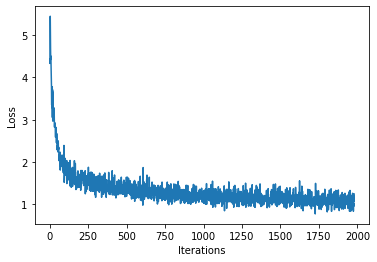

100%|██████████| 2000/2000 [00:49<00:00, 40.28it/s]


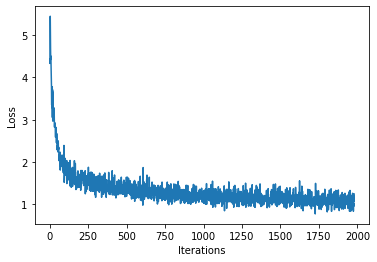

In [29]:
model = build_model(vocab_size, embedding_dim, rnn_units, batch_size)

optimizer = tf.keras.optimizers.Adam(learning_rate)

@tf.function
def train_step(x, y): 
  
  with tf.GradientTape() as tape:
  
    y_hat = model(x) 
    loss = compute_loss(y, y_hat) 

  grads = tape.gradient(loss, model.trainable_variables) # TODO
  optimizer.apply_gradients(zip(grads, model.trainable_variables))
  return loss

##################
# Begin training!#
##################

history = []
plotter = mdl.util.PeriodicPlotter(sec=2, xlabel='Iterations', ylabel='Loss')
if hasattr(tqdm, '_instances'): tqdm._instances.clear() # clear if it exists

for iter in tqdm(range(num_training_iterations)):

  x_batch, y_batch = get_batch(vectorized_songs, seq_length, batch_size)
  loss = train_step(x_batch, y_batch)

  history.append(loss.numpy().mean())
  plotter.plot(history)

  if iter % 100 == 0:     
    model.save_weights(checkpoint_prefix)

model.save_weights(checkpoint_prefix)

batch_size= 1 yapip tekrar modeli olusturalim

In [31]:
model = build_model(vocab_size, embedding_dim, rnn_units, batch_size=1) # TODO

model.load_weights(tf.train.latest_checkpoint(checkpoint_dir))
model.build(tf.TensorShape([1, None]))

model.summary()

Model: "sequential_5"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_5 (Embedding)     (1, None, 256)            21248     
                                                                 
 lstm_5 (LSTM)               (1, None, 1024)           5246976   
                                                                 
 dense_5 (Dense)             (1, None, 83)             85075     
                                                                 
Total params: 5,353,299
Trainable params: 5,353,299
Non-trainable params: 0
_________________________________________________________________


Sarki olsuturalim artik.

In [32]:
def generate_text(model, start_string, generation_length=1000):

  input_eval = [char2idx[s] for s in start_string]
  
  input_eval = tf.expand_dims(input_eval, 0)

  text_generated = []

  model.reset_states()
  tqdm._instances.clear()

  for i in tqdm(range(generation_length)):
      
      predictions = model(input_eval)      
      #  batch den olsuan fazla dimensionu kaldiralim
      predictions = tf.squeeze(predictions, 0)
      predicted_id = tf.random.categorical(predictions, num_samples=1)[-1,0].numpy()
      input_eval = tf.expand_dims([predicted_id], 0)
      text_generated.append(idx2char[predicted_id]) # TODO 

    
  return (start_string + ''.join(text_generated))

Sarkimizi olusturalim

In [33]:
generated_text = generate_text(model, start_string="X", generation_length=1000) 

100%|██████████| 1000/1000 [00:06<00:00, 165.78it/s]


Cal

In [34]:
generated_songs = mdl.lab1.extract_song_snippet(generated_text)

for i, song in enumerate(generated_songs): 
  
  waveform = mdl.lab1.play_song(song)
  if waveform:
    print("Generated song", i)
    ipythondisplay.display(waveform)

Found 2 songs in text
Generated song 1
